In [1]:
# might need to pip install yfinance
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import random
# !pip install kaggle

C:\Users\ynakadi\Anaconda3\lib\site-packages\yfinance\base.py:48: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  _empty_series = pd.Series()


#### Get S&P 500 Stocks

In [2]:
!!kaggle datasets download -d andrewmvd/sp-500-stocks --force
#!!kaggle datasets download -d williecosta/russell-3000-stock-history

['Downloading sp-500-stocks.zip to C:\\Users\\ynakadi\\Downloads',
 '',
 '  0%|          | 0.00/42.5M [00:00<?, ?B/s]',
 '  5%|4         | 2.00M/42.5M [00:00<00:03, 12.1MB/s]',
 '  9%|9         | 4.00M/42.5M [00:00<00:02, 13.5MB/s]',
 ' 14%|#4        | 6.00M/42.5M [00:00<00:02, 14.8MB/s]',
 ' 19%|#8        | 8.00M/42.5M [00:00<00:02, 14.2MB/s]',
 ' 24%|##3       | 10.0M/42.5M [00:00<00:02, 14.4MB/s]',
 ' 28%|##8       | 12.0M/42.5M [00:00<00:02, 14.5MB/s]',
 ' 33%|###2      | 14.0M/42.5M [00:01<00:02, 14.6MB/s]',
 ' 38%|###7      | 16.0M/42.5M [00:01<00:02, 13.7MB/s]',
 ' 42%|####2     | 18.0M/42.5M [00:01<00:01, 14.0MB/s]',
 ' 47%|####7     | 20.0M/42.5M [00:01<00:01, 14.7MB/s]',
 ' 52%|#####1    | 22.0M/42.5M [00:01<00:01, 15.2MB/s]',
 ' 56%|#####6    | 24.0M/42.5M [00:01<00:01, 16.2MB/s]',
 ' 61%|######1   | 26.0M/42.5M [00:01<00:01, 16.9MB/s]',
 ' 66%|######5   | 28.0M/42.5M [00:01<00:00, 17.5MB/s]',
 ' 71%|#######   | 30.0M/42.5M [00:02<00:00, 17.0MB/s]',
 ' 75%|#######5  | 32.0M/

In [2]:
import zipfile
file = 'sp-500-stocks.zip'
print('Unzipping:',file)

with zipfile.ZipFile(file, 'r') as zip_ref:
    zip_ref.extractall()

Unzipping: sp-500-stocks.zip


In [4]:
# file = 'russell-3000-stock-history.zip'
# print('Unzipping:',file)

# with zipfile.ZipFile(file, 'r') as zip_ref:
#     zip_ref.extractall()

In [3]:
sp500_df = pd.read_csv('sp500_companies.csv')
sp500_df.head(5)

,Exchange,Symbol,Shortname,Longname,Sector,Industry,Currentprice,Marketcap,Ebitda,Revenuegrowth,City,State,Country,Fulltimeemployees,Longbusinesssummary,Weight
0,NMS,MSFT,Microsoft Corporation,Microsoft Corporation,Technology,Software - Infrastructure,420.55,3124871299072,1.184270e+11,0.176,Redmond,WA,United States,221000.0,Microsoft Corporation develops and supports so...,0.066824
1,NMS,AAPL,Apple Inc.,Apple Inc.,Technology,Consumer Electronics,188.85,2916202840064,1.301090e+11,0.021,Cupertino,CA,United States,161000.0,"Apple Inc. designs, manufactures, and markets ...",0.062361
2,NMS,GOOG,Alphabet Inc.,Alphabet Inc.,Communication Services,Internet Content & Information,150.22,1821642850304,1.001720e+11,0.135,Mountain View,CA,United States,182502.0,Alphabet Inc. offers various products and plat...,0.038955
3,NMS,GOOGL,Alphabet Inc.,Alphabet Inc.,Communication Services,Internet Content & Information,149.00,1821525016576,1.001720e+11,0.135,Mountain View,CA,United States,182502.0,Alphabet Inc. offers various products and plat...,0.038952
4,NMS,AMZN,"Amazon.com, Inc.","Amazon.com, Inc.",Consumer Cyclical,Internet Retail,174.45,1812081803264,8.551500e+10,0.139,Seattle,WA,United States,1525000.0,"Amazon.com, Inc. engages in the retail sale of...",0.038750


In [6]:
# russell3000_df = pd.read_csv('prices.csv')
# russell3000_df.head(5)

In [4]:
#stocks_list = list(set(list(set(russell3000_df['symbol'])) + list(set(sp500_df['Symbol']))))
stocks_list = list(set(sp500_df['Symbol'])) 

In [5]:
start_date = "2018-01-01"
end_date = "2024-03-01"
stocks_df = pd.DataFrame()
random.shuffle(stocks_list)
for stock in (stocks_list[:15] + ['SPY']):
    df = yf.download(stock, start = start_date, end = end_date)
    df['company'] = stock
    stocks_df = pd.concat([stocks_df,df])
    
# Alternatively, you can do yf.download([stocks], start = start_date, end = end_date),
# but that leads to multi-index columns

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%*******

In [6]:
stocks_df

,Open,High,Low,Close,Adj Close,Volume,company
Date,,,,,,,
2018-01-02,31.937778,31.995556,31.053333,31.128889,27.387955,964800,WRB
2018-01-03,31.133333,31.324444,30.866667,30.871111,27.161158,764100,WRB
2018-01-04,30.924444,31.120001,30.844444,30.995556,27.270645,589725,WRB
2018-01-05,31.053333,31.053333,30.777779,30.866667,27.157249,808875,WRB
2018-01-08,30.831112,30.831112,30.497778,30.711111,27.020388,902925,WRB
...,...,...,...,...,...,...,...
2024-02-07,496.290009,498.529999,495.359985,498.100006,498.100006,70556500,SPY
2024-02-08,498.100006,498.709991,497.260010,498.320007,498.320007,52343600,SPY
2024-02-09,498.839996,501.649994,498.489990,501.200012,501.200012,63917600,SPY


In [7]:
stocks_df.describe()

,Open,High,Low,Close,Adj Close,Volume
count,24068.000000,24068.000000,24068.000000,24068.000000,24068.000000,2.406800e+04
mean,133.356571,134.767763,131.912706,133.355321,125.846141,8.988695e+06
std,161.413655,162.856233,159.926355,161.418761,152.887249,2.352231e+07
min,5.900000,6.230000,5.800000,5.950000,5.065809,0.000000e+00
25%,41.849166,42.549999,41.180000,41.820000,40.451256,9.695750e+05
50%,74.305000,75.185001,73.330002,74.274998,70.221951,1.998450e+06
75%,152.970005,154.822506,151.014999,152.637505,142.063805,5.702925e+06
max,971.520020,973.159973,962.309998,971.489990,913.899475,3.922207e+08


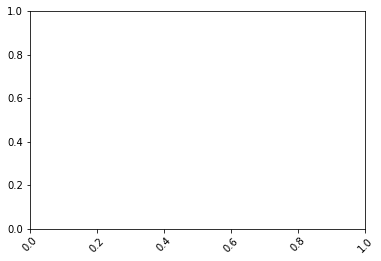

In [8]:
close_price_df = stocks_df.loc[:,['Close','company']].reset_index()
close_price_df
plt.xticks(rotation=45)
from matplotlib import rcParams

# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_df,x='Date',y='Close',color='company').update_layout(
    xaxis_title="Date", yaxis_title="Close Price ($)"
)

### Aggregate for Industry + Sector

In [9]:
industry_df = stocks_df.reset_index().merge(sp500_df[['Symbol','Sector','Industry']],left_on='company',right_on='Symbol').set_index('Date')
industry_df

,Open,High,Low,Close,Adj Close,Volume,company,Symbol,Sector,Industry
Date,,,,,,,,,,
2018-01-02,31.937778,31.995556,31.053333,31.128889,27.387955,964800,WRB,WRB,Financial Services,Insurance - Property & Casualty
2018-01-03,31.133333,31.324444,30.866667,30.871111,27.161158,764100,WRB,WRB,Financial Services,Insurance - Property & Casualty
2018-01-04,30.924444,31.120001,30.844444,30.995556,27.270645,589725,WRB,WRB,Financial Services,Insurance - Property & Casualty
2018-01-05,31.053333,31.053333,30.777779,30.866667,27.157249,808875,WRB,WRB,Financial Services,Insurance - Property & Casualty
2018-01-08,30.831112,30.831112,30.497778,30.711111,27.020388,902925,WRB,WRB,Financial Services,Insurance - Property & Casualty
...,...,...,...,...,...,...,...,...,...,...
2024-02-07,166.669998,168.639999,166.119995,166.729996,166.729996,1098400,AME,AME,Industrials,Specialty Industrial Machinery
2024-02-08,167.600006,167.830002,165.550003,166.300003,166.300003,976400,AME,AME,Industrials,Specialty Industrial Machinery
2024-02-09,166.410004,168.610001,166.410004,168.500000,168.500000,814700,AME,AME,Industrials,Specialty Industrial Machinery


In [10]:
close_price_industry_df = industry_df.loc[:,['Close','Volume','Industry']].reset_index()
close_price_industry_df['Total'] = close_price_industry_df['Close'] * close_price_industry_df['Volume']
close_price_industry_df = close_price_industry_df.groupby(by=['Date','Industry']).sum().reset_index()
close_price_industry_df['mean_price']  = close_price_industry_df['Total']  / close_price_industry_df['Volume']
close_price_industry_df = close_price_industry_df[['Date','Industry','mean_price']]
close_price_industry_df
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_industry_df,x='Date',y='mean_price',color='Industry').update_layout(
    xaxis_title="Date", yaxis_title="Close Price (Averaged for Industry)"
)

In [11]:
close_price_sector_df = industry_df.loc[:,['Close','Volume','Sector']].reset_index()
close_price_sector_df['Total'] = close_price_sector_df['Close'] * close_price_sector_df['Volume']
close_price_sector_df = close_price_sector_df.groupby(by=['Date','Sector']).sum().reset_index()
close_price_sector_df['Close']  = close_price_sector_df['Total']  / close_price_sector_df['Volume']
close_price_sector_df = close_price_sector_df[['Date','Sector','Close']]
close_price_sector_df

,Date,Sector,Close
0,2018-01-02,Basic Materials,102.333092
1,2018-01-02,Consumer Cyclical,NaN
2,2018-01-02,Consumer Defensive,80.620003
3,2018-01-02,Financial Services,50.155692
4,2018-01-02,Healthcare,89.510002
...,...,...,...
10768,2024-02-13,Consumer Defensive,51.509998
10769,2024-02-13,Financial Services,65.202131
10770,2024-02-13,Healthcare,304.519989
10771,2024-02-13,Industrials,64.491982


In [12]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_sector_df,x='Date',y='Close',color='Sector').update_layout(
    xaxis_title="Date", yaxis_title="Close Price (Averaged for Sector)"
)

In [118]:
industry_df

,Open,High,Low,Close,Adj Close,Volume,company,Symbol,Sector,Industry
Date,,,,,,,,,,
2018-01-02,76.680000,78.139999,76.389999,78.000000,78.000000,971400,MOH,MOH,Healthcare,Healthcare Plans
2018-01-03,77.910004,77.910004,76.279999,77.169998,77.169998,845600,MOH,MOH,Healthcare,Healthcare Plans
2018-01-04,77.650002,78.190002,77.279999,77.639999,77.639999,542100,MOH,MOH,Healthcare,Healthcare Plans
2018-01-05,77.980003,80.650002,77.910004,80.589996,80.589996,888400,MOH,MOH,Healthcare,Healthcare Plans
2018-01-08,80.599998,83.019997,79.769997,82.730003,82.730003,1785700,MOH,MOH,Healthcare,Healthcare Plans
...,...,...,...,...,...,...,...,...,...,...
2024-02-05,11.770000,11.770000,11.540000,11.580000,11.580000,5514200,VTRS,VTRS,Healthcare,Drug Manufacturers - Specialty & Generic
2024-02-06,11.670000,12.020000,11.640000,11.890000,11.890000,7450000,VTRS,VTRS,Healthcare,Drug Manufacturers - Specialty & Generic
2024-02-07,11.900000,11.920000,11.660000,11.740000,11.740000,6504900,VTRS,VTRS,Healthcare,Drug Manufacturers - Specialty & Generic


In [119]:
for sector in set(close_price_sector_df['Sector']):
    sector_df = close_price_sector_df[close_price_sector_df['Sector'] == sector]
    stock_df = industry_df[industry_df['Sector'] == sector].reset_index()[['Date','Close','Symbol']]
    stock_df = stock_df.rename(columns = {'Symbol':'Sector'})
    merge_df = pd.concat([stock_df,sector_df])
    rcParams['figure.figsize'] = 11.7,8.27
    fig = px.line(merge_df,x='Date',y='Close',color='Sector').update_layout(
        xaxis_title="Date", yaxis_title="Close Price (Averaged for Sector)"
    )
    fig.show()
    

## Normalization

In [13]:
close_price_pivot_df = close_price_df.pivot(index='Date',columns='company',values='Close')
close_price_norm_df = close_price_pivot_df.div(close_price_pivot_df.iloc[0]).mul(100)
close_price_norm_df = close_price_norm_df.stack().reset_index().rename(columns={0:'Close'})

# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_norm_df,x='Date',y='Close',color='company').update_layout(
    xaxis_title="Date", yaxis_title="Close Price (Normalized)"
)

### Delete Function

In [14]:
# del (...) 

### Pct Change (for Pandas)

#### Daily Change

In [15]:
close_price_shift_df = close_price_pivot_df.shift(periods=1)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [16]:
close_price_day_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_day_change_df['pct_change'] = 100*(close_price_day_change_df.Close_y - close_price_day_change_df.Close_x) / close_price_day_change_df.Close_x
close_price_day_change_df

,Date,company,Close_x,Close_y,pct_change
0,2018-01-03,AMCR,11.800000,11.800000,0.000000
1,2018-01-03,AME,72.750000,73.389999,0.879724
2,2018-01-03,AXON,26.549999,26.750000,0.753299
3,2018-01-03,BLK,508.970001,514.340027,1.055077
4,2018-01-03,CMA,86.570000,86.540001,-0.034653
...,...,...,...,...,...
24047,2024-02-13,SPY,500.980011,494.720001,-1.249553
24048,2024-02-13,SYF,39.529999,38.410000,-2.833289
24049,2024-02-13,TSN,52.549999,51.509998,-1.979069
24050,2024-02-13,UAL,43.020000,41.319099,-3.953745


In [17]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_day_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="DoD Change in Stock Price"
)

#### Weekly Change

In [18]:
close_price_shift_df = close_price_pivot_df.shift(periods=7)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [19]:
close_price_week_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_week_change_df['pct_change'] = 100*(close_price_week_change_df.Close_y - close_price_week_change_df.Close_x) / close_price_week_change_df.Close_x
close_price_week_change_df

,Date,company,Close_x,Close_y,pct_change
0,2018-01-11,AMCR,11.800000,11.800000,0.000000
1,2018-01-11,AME,72.750000,74.570000,2.501718
2,2018-01-11,AXON,26.549999,26.900000,1.318269
3,2018-01-11,BLK,508.970001,537.919983,5.687954
4,2018-01-11,CMA,86.570000,92.519997,6.873047
...,...,...,...,...,...
23951,2024-02-13,SPY,494.350006,494.720001,0.074845
23952,2024-02-13,SYF,38.950001,38.410000,-1.386395
23953,2024-02-13,TSN,56.360001,51.509998,-8.605398
23954,2024-02-13,UAL,41.369999,41.319099,-0.123035


In [20]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_week_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="WoW Change in Stock Price"
)

#### Monthly Change

In [21]:
close_price_shift_df = close_price_pivot_df.shift(periods=30)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [22]:
close_price_month_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_month_change_df['pct_change'] = 100*(close_price_month_change_df.Close_y - close_price_month_change_df.Close_x) / close_price_month_change_df.Close_x
close_price_month_change_df

,Date,company,Close_x,Close_y,pct_change
0,2018-02-14,AMCR,11.800000,11.440000,-3.050853
1,2018-02-14,AME,72.750000,74.709999,2.694157
2,2018-02-14,AXON,26.549999,27.920000,5.160079
3,2018-02-14,BLK,508.970001,539.940002,6.084838
4,2018-02-14,CMA,86.570000,97.400002,12.510110
...,...,...,...,...,...
23583,2024-02-13,SPY,475.309998,494.720001,4.083651
23584,2024-02-13,SYF,38.189999,38.410000,0.576070
23585,2024-02-13,TSN,53.750000,51.509998,-4.167445
23586,2024-02-13,UAL,41.259998,41.319099,0.143241


In [23]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_month_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="MoM Change in Stock Price"
)

#### Yearly Change

In [24]:
close_price_shift_df = close_price_pivot_df.shift(periods=365)
close_price_shift_df = close_price_shift_df.stack().reset_index().rename(columns={0:'Close'})

In [25]:
close_price_year_change_df = close_price_shift_df.merge(close_price_df, on = ['Date','company'])
close_price_year_change_df['pct_change'] = 100*(close_price_year_change_df.Close_y - close_price_year_change_df.Close_x) / close_price_year_change_df.Close_x
close_price_year_change_df

,Date,company,Close_x,Close_y,pct_change
0,2019-06-17,AMCR,11.800000,10.650000,-9.745767
1,2019-06-17,AME,72.750000,84.449997,16.082470
2,2019-06-17,AXON,26.549999,68.169998,156.760829
3,2019-06-17,BLK,508.970001,440.119995,-13.527321
4,2019-06-17,CMA,86.570000,69.199997,-20.064691
...,...,...,...,...,...
18223,2024-02-13,SPY,398.209991,494.720001,24.235959
18224,2024-02-13,SYF,32.959999,38.410000,16.535197
18225,2024-02-13,TSN,76.739998,51.509998,-32.877248
18226,2024-02-13,UAL,35.939999,41.319099,14.966892


In [26]:
# figure size in inches
rcParams['figure.figsize'] = 11.7,8.27
px.line(close_price_year_change_df,x='Date',y='pct_change',color='company').update_layout(
    xaxis_title="Date", yaxis_title="YoY Change in Stock Price"
)

### Specific Sample of Data

In [27]:
# Last Day of Month
close_price_df.set_index("Date").resample("M").last()

# Last Business Day
close_price_df.set_index("Date").resample("BM").last()

,Close,company
Date,,
2018-01-31,281.899994,SPY
2018-02-28,271.649994,SPY
2018-03-30,263.149994,SPY
2018-04-30,264.510010,SPY
2018-05-31,270.940002,SPY
...,...,...
2023-10-31,418.200012,SPY
2023-11-30,456.399994,SPY
2023-12-29,475.309998,SPY


### Histogram

<Axes: >

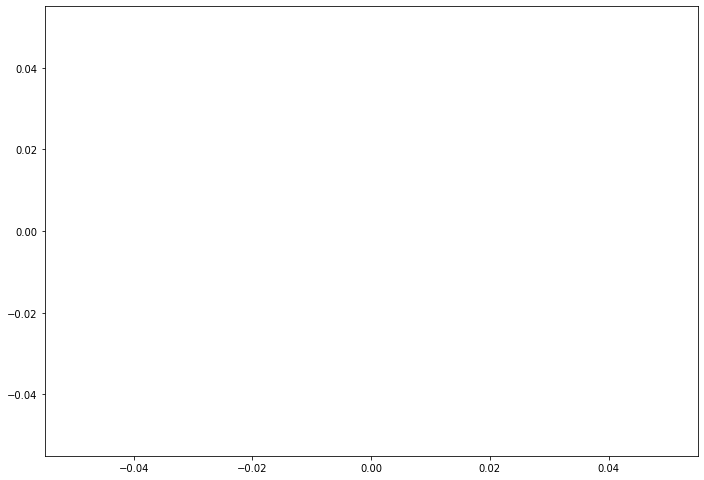

In [28]:
company = 'LLY'
pct_change_vals = close_price_day_change_df[close_price_day_change_df['company'] == company]['pct_change']
sns.histplot(pct_change_vals,bins=100)

In [29]:
print(np.mean(pct_change_vals))
print(np.std(pct_change_vals))
print(np.var(pct_change_vals))

nan
nan
nan


In [30]:
company_comp_df = close_price_day_change_df[['company','pct_change']].groupby(by='company').agg({'pct_change':['mean','std']})

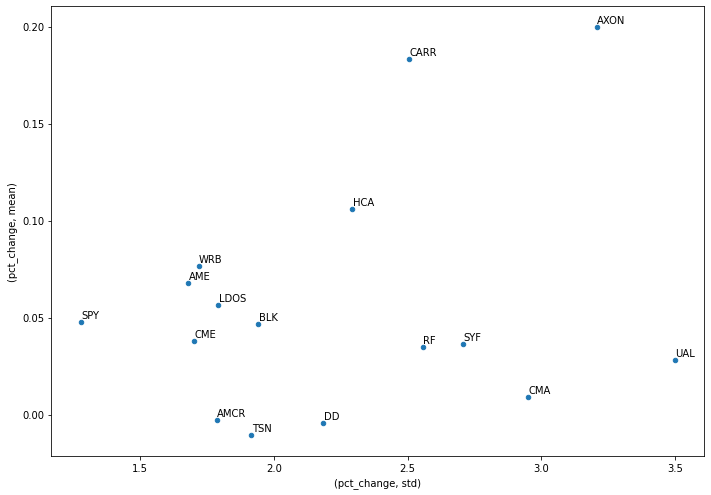

In [31]:
company_comp_df.plot.scatter(x=('pct_change','std'),y=('pct_change','mean'))
for i in company_comp_df.index:
    plt.annotate(i, xy= (company_comp_df.loc[i,('pct_change','std')]+2e-3, company_comp_df.loc[i,('pct_change','mean')]+2e-3))

### Correlation + Covariance

In [32]:
close_price_day_comp_df = close_price_day_change_df[['Date','company','pct_change']].pivot(index='Date',columns='company',values='pct_change')

#### Covariance

In [33]:
close_price_day_comp_df.cov()

company,AMCR,AME,AXON,BLK,CARR,CMA,CME,DD,HCA,LDOS,RF,SPY,SYF,TSN,UAL,WRB
company,,,,,,,,,,,,,,,,
AMCR,3.191716,1.695019,1.624530,1.855633,1.665693,2.241974,1.268512,1.882324,1.865324,1.152428,2.286613,1.314655,2.339242,1.352316,2.284995,1.429770
AME,1.695019,2.822654,1.972891,2.326289,2.036692,2.708838,1.419705,2.378231,2.174308,1.614599,2.634105,1.746689,2.734529,1.299726,2.649281,1.778181
AXON,1.624530,1.972891,10.278719,2.372859,2.143713,2.397908,1.177981,2.090452,2.200203,1.414558,2.415348,1.889517,2.658809,1.374605,3.290206,1.279599
BLK,1.855633,2.326289,2.372859,3.768858,2.182126,3.164389,1.670954,2.547547,2.145508,1.668668,3.083873,2.030676,3.280094,1.390816,2.775797,1.755437
CARR,1.665693,2.036692,2.143713,2.182126,6.271009,3.161597,1.344109,2.379109,1.903177,1.107232,2.658488,1.513368,2.888568,1.098404,3.651234,1.377141
CMA,2.241974,2.708838,2.397908,3.164389,3.161597,8.706196,1.985490,3.701145,3.030240,2.094255,6.520368,2.205603,5.686096,2.309315,5.888239,2.816586
CME,1.268512,1.419705,1.177981,1.670954,1.344109,1.985490,2.895741,1.516433,1.490232,1.309350,2.024052,1.218393,2.010162,1.072985,1.805057,1.537117
DD,1.882324,2.378231,2.090452,2.547547,2.379109,3.701145,1.516433,4.775503,2.197834,1.648604,3.469657,1.871017,3.527509,1.437562,3.735784,1.894259
HCA,1.865324,2.174308,2.200203,2.145508,1.903177,3.030240,1.490232,2.197834,5.261674,1.623379,2.966108,1.704089,3.252235,1.832768,3.384346,1.660865


#### Correlation

In [34]:
close_price_day_comp_df.corr()

company,AMCR,AME,AXON,BLK,CARR,CMA,CME,DD,HCA,LDOS,RF,SPY,SYF,TSN,UAL,WRB
company,,,,,,,,,,,,,,,,
AMCR,1.000000,0.564720,0.283626,0.535026,0.385048,0.425309,0.417256,0.482140,0.455177,0.359811,0.500619,0.574640,0.483906,0.395056,0.365760,0.465376
AME,0.564720,1.000000,0.366273,0.713231,0.515392,0.546437,0.496580,0.647762,0.564196,0.536053,0.613241,0.811863,0.601522,0.403753,0.450944,0.615455
AXON,0.283626,0.366273,1.000000,0.381239,0.281066,0.253483,0.215918,0.298374,0.299179,0.246107,0.294671,0.460232,0.306489,0.223770,0.293479,0.232089
BLK,0.535026,0.713231,0.381239,1.000000,0.442787,0.552422,0.505801,0.600493,0.481796,0.479443,0.621324,0.816830,0.624423,0.373902,0.408889,0.525811
CARR,0.385048,0.515392,0.281066,0.442787,1.000000,0.392209,0.333796,0.448954,0.332510,0.250347,0.398883,0.488979,0.404397,0.240843,0.381169,0.312768
CMA,0.425309,0.546437,0.253483,0.552422,0.392209,1.000000,0.395434,0.574001,0.447714,0.395902,0.864340,0.583726,0.712193,0.408471,0.570682,0.555083
CME,0.417256,0.496580,0.215918,0.505801,0.333796,0.395434,1.000000,0.407787,0.381779,0.429188,0.465231,0.559118,0.436565,0.329084,0.303343,0.525263
DD,0.482140,0.647762,0.298374,0.600493,0.448954,0.574001,0.407787,1.000000,0.438453,0.420803,0.621017,0.668596,0.596563,0.343328,0.488872,0.504056
HCA,0.455177,0.564196,0.299179,0.481796,0.332510,0.447714,0.381779,0.438453,1.000000,0.394757,0.505768,0.580131,0.523983,0.417002,0.421926,0.421038


<Axes: xlabel='company', ylabel='company'>

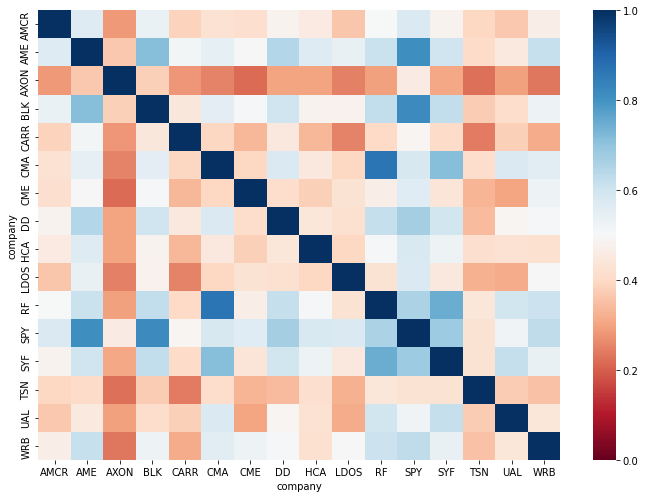

In [35]:
sns.heatmap(close_price_day_comp_df.corr(),cmap = 'RdBu',vmin = 0, vmax = 1)

## Simple returns and log returns

In [36]:
# Simple returns can be misleading
# Log returns is muchhhh more accurate

In [37]:
stocks_df[['Close','company']]

,Close,company
Date,,
2018-01-02,31.128889,WRB
2018-01-03,30.871111,WRB
2018-01-04,30.995556,WRB
2018-01-05,30.866667,WRB
2018-01-08,30.711111,WRB
...,...,...
2024-02-07,498.100006,SPY
2024-02-08,498.320007,SPY
2024-02-09,501.200012,SPY


In [38]:
# Forward fill fillna(method = 'ffill')
# Backward fill fillna(method = 'bfill')

## Cumulative Returns + Drawdowns

In [39]:
# Cumulative Max (cummax)
# Cumulative Sum (cumsum)

4
WRB
2020-03-23 00:00:00


SPY
2020-03-23 00:00:00


CME
2020-03-23 00:00:00


UAL
2020-05-15 00:00:00


CARR
2022-10-20 00:00:00


AME
2020-03-23 00:00:00


RF
2020-03-18 00:00:00


SYF
2020-03-23 00:00:00


AMCR
2020-03-16 00:00:00


AXON
2022-05-11 00:00:00


LDOS
2020-03-23 00:00:00


HCA
2020-03-18 00:00:00


DD
2020-03-23 00:00:00


CMA
2020-04-16 00:00:00


TSN
2023-10-23 00:00:00


BLK
2022-10-12 00:00:00




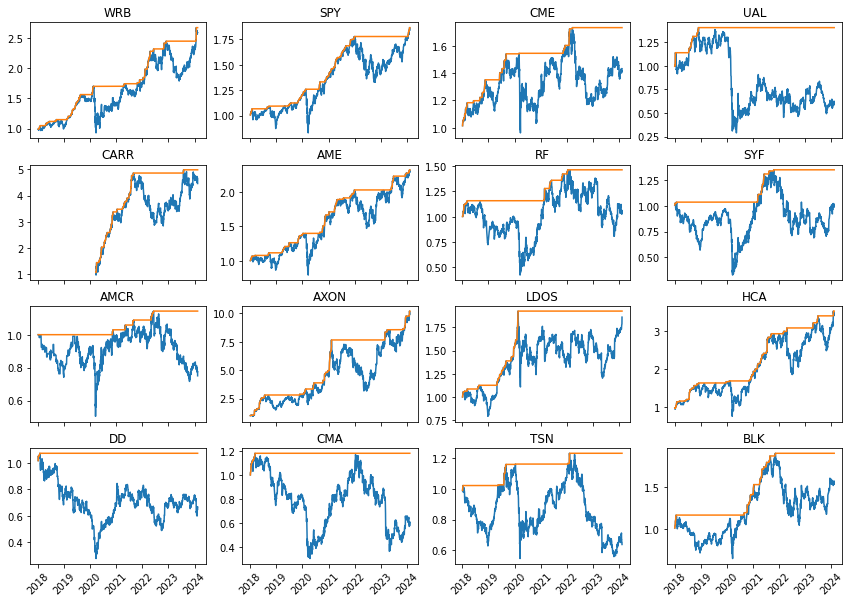

<Figure size 5760x5760 with 0 Axes>

In [40]:
companies = list(set(stocks_df['company']))
size = int(np.sqrt(len(companies)))
print(size)
fig, axs = plt.subplots(size,size,sharex=True,layout='constrained')
plt.figure(figsize=(80,80))
for i in range(len(companies)):
    x = i // size
    y = i % size
    company = companies[i]
    returns_df = stocks_df[stocks_df['company']==company][['Close']]
    returns_df['d_returns'] = np.log(returns_df[['Close']].div(returns_df[['Close']].shift(1)))
    returns_df['cum_returns'] = returns_df.d_returns.cumsum().apply(np.exp)
    returns_df['cum_max'] = returns_df.cum_returns.cummax()
    returns_df['Drawdown_Percentage'] = (returns_df['cum_max'] - returns_df['cum_returns']) / returns_df['cum_max']
    print(company)
    print(returns_df.Drawdown_Percentage.idxmax())
    print('\n')
    axs[x,y].plot(returns_df[['cum_returns','cum_max']])
    axs[x,y].tick_params(axis='x', rotation=45)
    axs[x,y].title.set_text(str(company)) 


## Backtesting

In [41]:
RTX_df = stocks_df[stocks_df['company']=='TSLA'][['Close']]

In [42]:
# Moving average [mean + median]
num_days = 50
RTX_roll = RTX_df.rolling(window=num_days)
RTX_roll_mean = RTX_roll.mean()
RTX_roll_median = RTX_roll.median()

<Axes: xlabel='Date'>

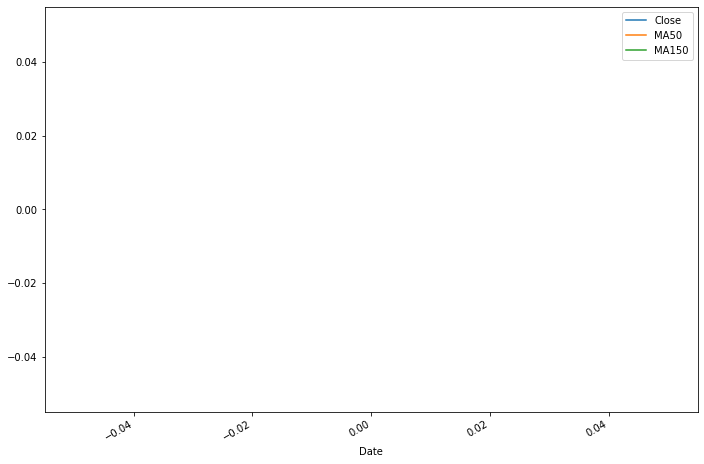

In [43]:
RTX_df['MA50'] = RTX_df[['Close']].rolling(window=num_days).mean()
RTX_df['MA150'] = RTX_df[['Close']].rolling(window=num_days*3).mean()

RTX_df.plot()

<Axes: xlabel='Date'>

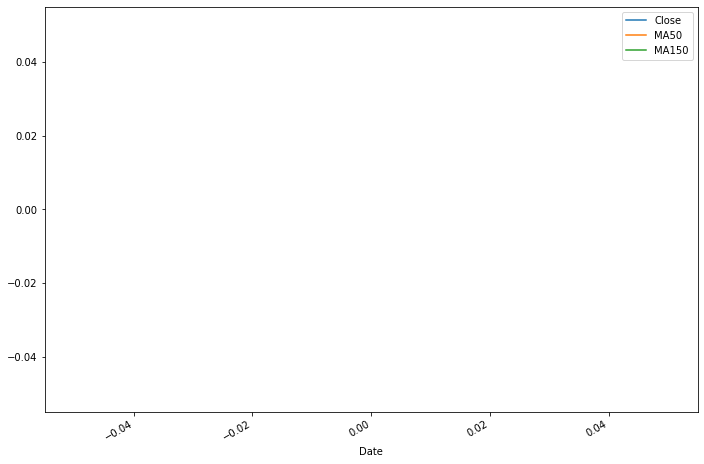

In [44]:
RTX_df.dropna(inplace=True)
RTX_df.plot()

In [45]:
# Short bias
RTX_df['position_short'] = np.where(RTX_df['MA50'] < RTX_df['MA150'],1,-1)

# Long bias
RTX_df['position_long'] = np.where(RTX_df['MA50'] > RTX_df['MA150'],1,-1)

<Axes: xlabel='Date'>

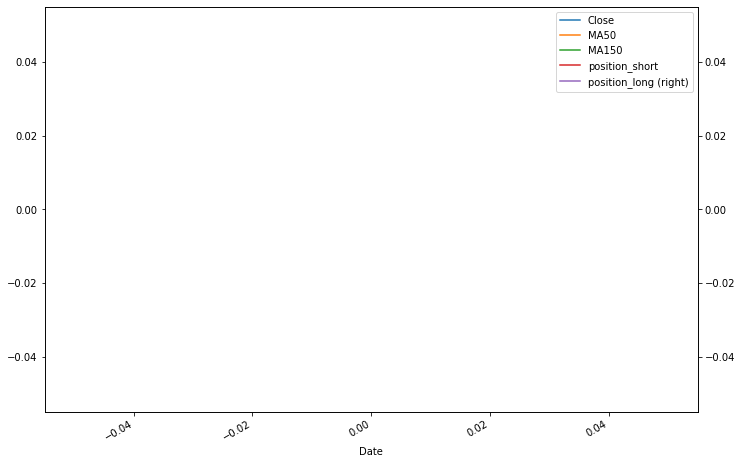

In [46]:
RTX_df.plot(secondary_y='position_long')

In [47]:
RTX_df['returnsb&h'] = np.log(RTX_df[['Close']].div(RTX_df[['Close']].shift(1)))
RTX_df['strategy_long'] = RTX_df['returnsb&h'] * RTX_df['position_long'].shift(1)
RTX_df['strategy_short'] = RTX_df['returnsb&h'] * RTX_df['position_short'].shift(1)

### Compare

In [48]:
print(RTX_df[['returnsb&h','strategy_long','strategy_short']].sum())
print(RTX_df[['returnsb&h','strategy_long','strategy_short']].std()*np.sqrt(252))

returnsb&h        0.0
strategy_long     0.0
strategy_short    0.0
dtype: float64
returnsb&h       NaN
strategy_long    NaN
strategy_short   NaN
dtype: float64


In [49]:
RTX_df[['returnsb&h','strategy_long','strategy_short']].sum().apply(np.exp) # What 1 dollar is worth

returnsb&h        1.0
strategy_long     1.0
strategy_short    1.0
dtype: float64

## Function

In [50]:
def test_strategy(stock,SMA):
    df = stocks_df[stocks_df['company'] == stock]
    RTX_df= df.Close.to_frame()
    RTX_df['SMA_S'] = RTX_df[['Close']].rolling(window=int(SMA[0])).mean()
    RTX_df['SMA_L'] = RTX_df[['Close']].rolling(window=int(SMA[1])).mean()
    RTX_df['returnsb&h'] = np.log(RTX_df[['Close']].div(RTX_df[['Close']].shift(1)))
    RTX_df.dropna(inplace=True)
    # Short bias
    RTX_df['position_short'] = np.where(RTX_df['SMA_S'] < RTX_df['SMA_L'],1,-1)

    # Long bias
    RTX_df['position_long'] = np.where(RTX_df['SMA_S'] > RTX_df['SMA_L'],1,-1)
    
    RTX_df['strategy_long'] = RTX_df['returnsb&h'] * RTX_df['position_long'].shift(1)
    RTX_df['strategy_short'] = RTX_df['returnsb&h'] * RTX_df['position_short'].shift(1)
    
    long_returns = np.exp(RTX_df['strategy_long'].sum())
    long_std = RTX_df['strategy_long'].std() * np.sqrt(252)
    
    short_returns = np.exp(RTX_df['strategy_short'].sum())
    short_std = RTX_df['strategy_short'].std() * np.sqrt(252)
    
    return (long_returns, long_std), (short_returns,short_std)

In [51]:
test_strategy("SPY",(50,200))

((1.0402742910386302, 0.21133422274788285),
 (0.9612849309210367, 0.21133422274788285))

In [52]:
class SMA_Backtester():
    def __init__(self, stock, SMA_S, SMA_L):
        self.stock = stock
        self.SMA_S = SMA_S
        self.SMA_L = SMA_L
        self.results = None
        self.get_data()
        
    def get_data(self):
        df = stocks_df[stocks_df['company'] == self.stock]
        RTX_df= df.Close.to_frame()
        RTX_df['SMA_S'] = RTX_df[['Close']].rolling(window=int(self.SMA_S)).mean()
        RTX_df['SMA_L'] = RTX_df[['Close']].rolling(window=int(self.SMA_L)).mean()
        RTX_df['returns'] = np.log(RTX_df[['Close']].div(RTX_df[['Close']].shift(1)))
        RTX_df.dropna(inplace=True)
        self.data2 = RTX_df
        return RTX_df
    
    def test_results(self):
        # Short bias
        data = self.data2.copy().dropna()
        data['position_short'] = np.where(data['SMA_S'] < data['SMA_L'],1,-1)

        # Long bias
        data['position_long'] = np.where(data['SMA_S'] > data['SMA_L'],1,-1)

        data['strategy_long'] = data['returns'] * data['position_long'].shift(1)
        data['strategy_short'] = data['returns'] * data['position_short'].shift(1)
        
        data['returnsbh'] = data['returns'].cumsum().apply(np.exp)
        data['return_strategy_long'] = data['strategy_long'].cumsum().apply(np.exp)
        data['return_strategy_short'] = data['strategy_short'].cumsum().apply(np.exp)
        
        short_perf = data['return_strategy_short'].iloc[-1]
        long_perf = data['return_strategy_long'].iloc[-1]
        
        short_outperf = short_perf - data['returnsbh'].iloc[-1]
        long_outperf = long_perf - data['returnsbh'].iloc[-1]
        self.results = data
        
        #         long_returns = np.exp(data['strategy_long'].sum())
        #         long_std = data['strategy_long'].std() * np.sqrt(252)

        #         short_returns = np.exp(data['strategy_short'].sum())
        #         short_std = data['strategy_short'].std() * np.sqrt(252)
        return (round(short_perf,4),round(short_outperf,4)), (round(long_perf,4),round(long_outperf,4))
    
    def plot_results(self):
        if self.results is None:
            print("Run the Test")
        else:
            title = "{}| SMA_S={} | SMA_L={}".format(self.stock, self.SMA_S, self.SMA_L)
            self.results[['returnsbh','return_strategy_short','return_strategy_long']].plot(title = title, figsize = (20,15))



In [53]:
x = SMA_Backtester('SPY',100,200)

In [54]:
x.test_results()

((0.8995, -0.9035), (1.1118, -0.6911))

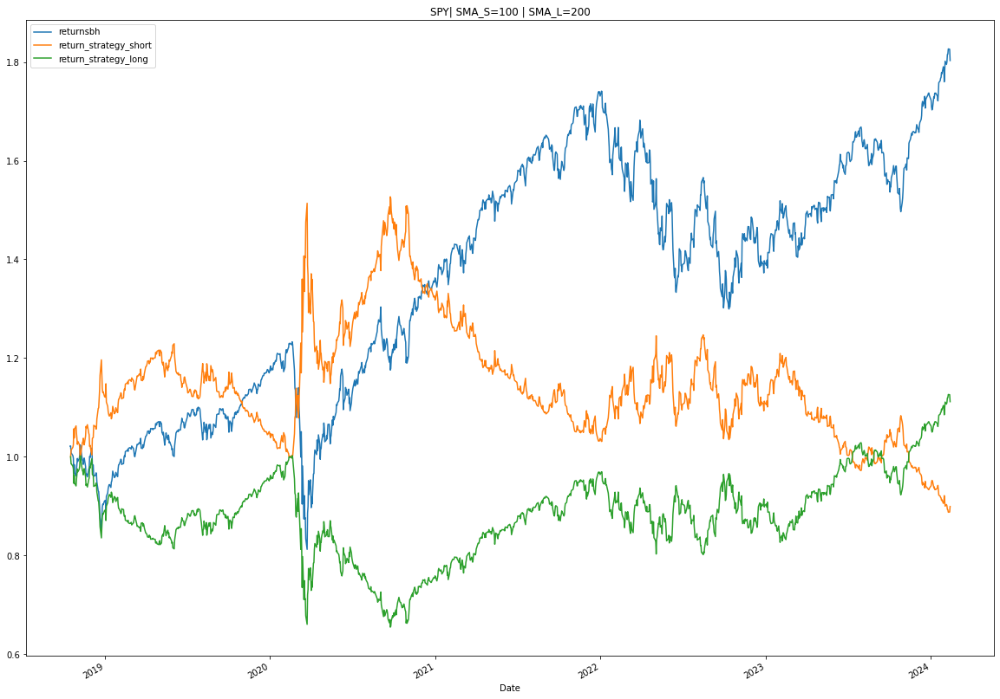

In [55]:
x.plot_results()

## API

In [164]:
# !pip install alpha_vantage

In [56]:
from alpha_vantage.timeseries import TimeSeries

In [57]:
API_key = 'ZXQLHOI678WR78YB'

In [58]:
ts = TimeSeries(key=API_key,output_format='pandas')

In [59]:
data = ts.get_weekly('AAPL')
data[0]

,1. open,2. high,3. low,4. close,5. volume
date,,,,,
2024-02-12,188.415,188.67,186.79,187.15,41781934.0
2024-02-09,188.150,191.05,185.84,188.85,252715796.0
2024-02-02,192.010,192.20,179.25,185.85,325909883.0
2024-01-26,192.300,196.38,191.94,192.42,255368848.0
2024-01-19,182.160,191.95,180.30,191.56,259829213.0
...,...,...,...,...,...
1999-12-10,114.560,118.00,99.00,103.00,25152800.0
1999-12-03,94.250,115.56,93.25,115.00,28046300.0
1999-11-26,91.750,95.50,88.50,95.06,9757600.0


## Weinstein Trading Strategy

In [62]:
stocks_df

,Open,High,Low,Close,Adj Close,Volume,company
Date,,,,,,,
2018-01-02,31.937778,31.995556,31.053333,31.128889,27.387955,964800,WRB
2018-01-03,31.133333,31.324444,30.866667,30.871111,27.161158,764100,WRB
2018-01-04,30.924444,31.120001,30.844444,30.995556,27.270645,589725,WRB
2018-01-05,31.053333,31.053333,30.777779,30.866667,27.157249,808875,WRB
2018-01-08,30.831112,30.831112,30.497778,30.711111,27.020388,902925,WRB
...,...,...,...,...,...,...,...
2024-02-07,496.290009,498.529999,495.359985,498.100006,498.100006,70556500,SPY
2024-02-08,498.100006,498.709991,497.260010,498.320007,498.320007,52343600,SPY
2024-02-09,498.839996,501.649994,498.489990,501.200012,501.200012,63917600,SPY


C:\Users\ynakadi\AppData\Local\Temp/ipykernel_20084/132233549.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ynakadi\AppData\Local\Temp/ipykernel_20084/132233549.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Date,Open,High,Low,Close,Adj Close,Volume,company,SMA_S,date_str
0,2018-08-06,68.099998,69.110001,65.190002,66.860001,66.860001,1075400,AXON,47.267467,2018-08-06 00:00:00
1,2018-08-07,67.010002,68.160004,66.139999,67.620003,67.620003,1030700,AXON,47.541267,2018-08-07 00:00:00
2,2018-08-08,63.189999,63.189999,56.090000,59.779999,59.779999,4298400,AXON,47.761467,2018-08-08 00:00:00
3,2018-08-09,60.500000,61.860001,59.220001,59.330002,59.330002,1102300,AXON,47.978133,2018-08-09 00:00:00
4,2018-08-10,59.270000,61.939999,58.040001,61.470001,61.470001,762400,AXON,48.208933,2018-08-10 00:00:00
...,...,...,...,...,...,...,...,...,...,...
1385,2024-02-07,260.339996,270.950012,259.119995,265.470001,265.470001,784900,AXON,218.461266,2024-02-07 00:00:00
1386,2024-02-08,265.000000,269.500000,264.529999,269.000000,269.000000,306100,AXON,218.995800,2024-02-08 00:00:00
1387,2024-02-09,270.820007,271.390015,268.440002,270.980011,270.980011,247600,AXON,219.548333,2024-02-09 00:00:00
1388,2024-02-12,270.529999,273.540009,265.049988,266.709991,266.709991,482600,AXON,220.024000,2024-02-12 00:00:00


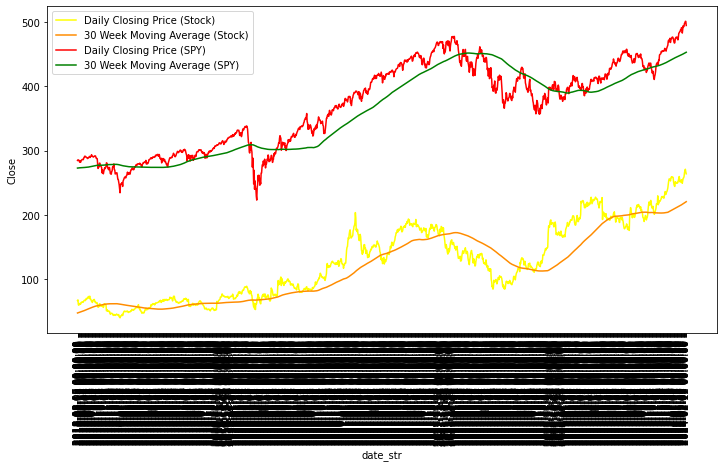

In [97]:
df = stocks_df[stocks_df['company'] == 'AXON']
spy_df = stocks_df[stocks_df['company'] == 'SPY']
df['SMA_S'] = df[['Close']].rolling(window=30*5).mean()
spy_df['SMA_S'] = spy_df[['Close']].rolling(window=30*5).mean()

df = df.dropna().reset_index()
spy_df = spy_df.dropna().reset_index()

df['date_str'] = df['Date'].apply(lambda x: str(x))
spy_df['date_str'] = spy_df['Date'].apply(lambda x: str(x))

fig, ax1 = plt.subplots(figsize=(12,6))
sns.lineplot(df, x="date_str", y="Close",label='Daily Closing Price (Stock)',ax=ax1,color = 'yellow')
sns.lineplot(df, x="date_str", y="SMA_S",label='30 Week Moving Average (Stock)', ax=ax1,color = 'darkorange')
sns.lineplot(spy_df, x="date_str", y="Close",label='Daily Closing Price (SPY)',ax=ax1,color = 'red')
sns.lineplot(spy_df, x="date_str", y="SMA_S",label='30 Week Moving Average (SPY)', ax=ax1,color = 'green')

plt.xticks(rotation=90)
# ax2 = ax1.twinx()

# sns.barplot(df, x="date_str", y="Volume",ax=ax2,color='mediumblue')



# ax2.set_ylabel("Share Price",color='mediumblue')
df

<Axes: xlabel='Date', ylabel='SMA_S'>

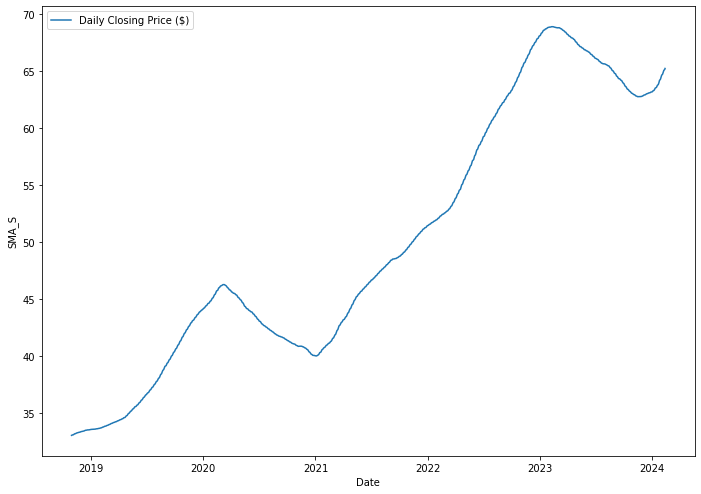

In [79]:
sns.lineplot(df, x="Date", y="SMA_S",label='Daily Closing Price ($)')